# Analisis temporal para la imputacion de una serie de tiempo

Esta sera una rutina con la cual analizaremos la correlacion temporal de la sere misma para hacer imputaciond e datos faltantes

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns 
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.neural_network import MLPRegressor
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from api_somo import fetch_and_process_data
from utils.utils import reshample_time_serie, categorize_precipitation, qf_monthly_report
from graphics_utils.express import fig_boxplot, fig_lineplot, fig_scatter, fig_pie_month
from statistics_utils.eda.timeseries import decompose_time_series, test_stationarity
from graphics_utils.go import multi_scatter

In [2]:
# PARAMETROS PARA OBTENER SERIE DE TIEMPO DESDE LA API SOMO

api_filtrate_seire = "http://127.0.0.1:8000/database/filter-serie-qf/"

tumaco_fetch = {"station_name": "tumaco","variable_name": "Precipitación acumulada","processing_level_name": "Control de calidad",}

data_station = fetch_and_process_data(api_filtrate_seire, tumaco_fetch)


# Muestra el DataFrame unificado
print(data_station)

                           value  qf  month
timestamp                                  
2009-02-01 05:10:00+00:00    0.0   1      2
2009-02-01 05:20:00+00:00    0.0   1      2
2009-02-01 05:30:00+00:00    0.0   1      2
2009-02-01 05:40:00+00:00    0.0   1      2
2009-02-01 05:50:00+00:00    0.0   1      2
...                          ...  ..    ...
2023-01-01 04:10:00+00:00    0.0   1      1
2023-01-01 04:20:00+00:00    0.0   1      1
2023-01-01 04:30:00+00:00    0.0   1      1
2023-01-01 04:40:00+00:00    0.0   1      1
2023-01-01 04:50:00+00:00    0.0   1      1

[731807 rows x 3 columns]


In [3]:
fig_boxplot_tum = fig_scatter(data_station, tumaco_fetch)
fig_boxplot_tum.show()

In [4]:
pie_fig = fig_pie_month(data_station,tumaco_fetch)
pie_fig.show()

d:\master BigData\01 proyecto final\codigos\bigdata\utils\utils.py:38: UserWarning:

Converting to PeriodArray/Index representation will drop timezone information.



   Año-Mes  QF  Conteo  Porcentaje
0  2009-02   1    4001  100.000000
1  2009-03   1    4463   99.977599
2  2009-03   9       1    0.022401
3  2009-04   1    4320  100.000000
4  2009-05   1    4464  100.000000
Index(['Año-Mes', 'QF', 'Conteo', 'Porcentaje'], dtype='object')


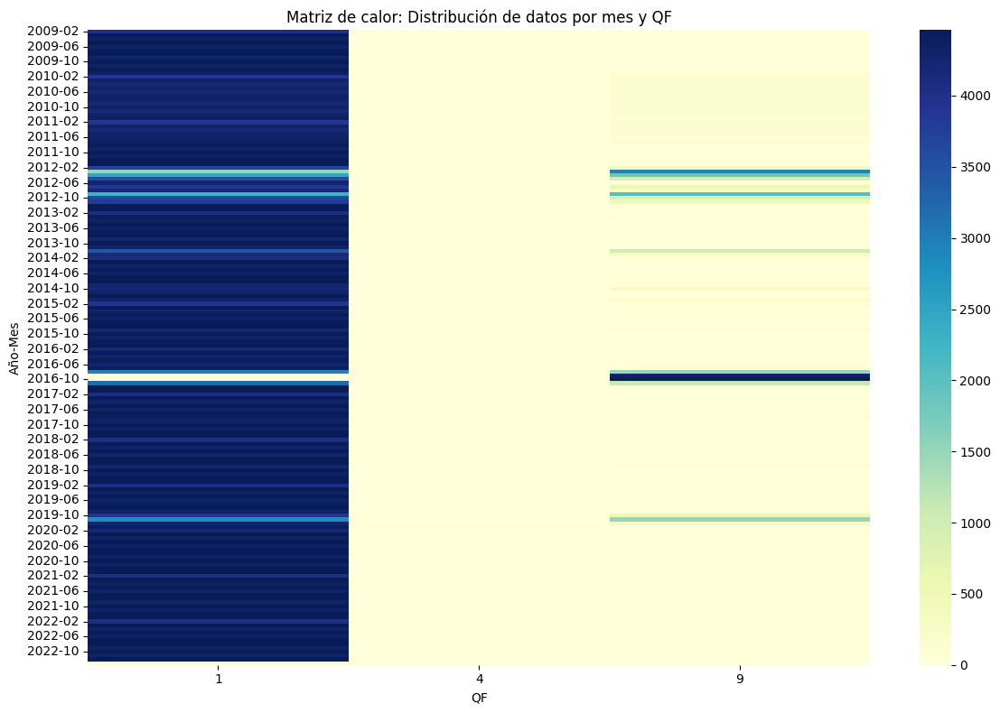

In [5]:
# Generar el reporte
report = qf_monthly_report(data_station)

# Verificar el contenido del reporte
print(report.head())
print(report.columns)

# Crear la tabla pivote
heatmap_data = report.pivot_table(
    index="Año-Mes",  # Filas: Meses
    columns="QF",     # Columnas: Factores de Calidad
    values="Conteo",  # Valores: Conteo de cada QF
    aggfunc="sum",    # Agregar valores duplicados
    fill_value=0      # Rellenar valores faltantes con 0
)

# Crear la matriz de calor
plt.figure(figsize=(12, 8))
sns.heatmap(heatmap_data, annot=False, fmt=".0f", cmap="YlGnBu")
plt.title("Matriz de calor: Distribución de datos por mes y QF")
plt.ylabel("Año-Mes")
plt.xlabel("QF")
plt.tight_layout()
plt.show()


In [8]:
import matplotlib.pyplot as plt
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

data_station_d = reshample_time_serie(data_station, 'ME', 'sum')
data_station_d=data_station_d.iloc['2009']

# Graficar ACF y PACF para la serie original o diferenciada
fig, ax = plt.subplots(2, 1, figsize=(12, 8))

plot_acf(data_station_d['value'].dropna(), lags=40, ax=ax[0])
ax[0].set_title("ACF (Autocorrelación)")

plot_pacf(data_station_d['value'].dropna(), lags=40, ax=ax[1])
ax[1].set_title("PACF (Autocorrelación Parcial)")

plt.tight_layout()
plt.show()

TypeError: Cannot index by location index with a non-integer key